# Time Crystal hamiltonian reproducing

In [1]:
%pylab inline

Populating the interactive namespace from numpy and matplotlib


In [2]:
def spines(ax=None):
    if ax is None:
        ax = plt.gca()
    dict(ax.spines.items())["left"].set_position(('outward', 10))
    dict(ax.spines.items())["bottom"].set_position(('outward', 10))
    dict(ax.spines.items())["top"].set_position(('outward', 10))
    dict(ax.spines.items())["right"].set_position(('outward', 10))
    
def annotate_distance(ax, text, point1, point2, linestyle, fontsize, textoffset = (0.1,0)):
    ax.annotate('', point1, point2, \
            arrowprops={'arrowstyle':'<->', 'linestyle':linestyle, "facecolor":"black"}, fontsize=fontsize);
    ax.annotate(text, point1, (0.5*(point1[0]+point2[0])+textoffset[0], 0.5*(point1[1]+point2[1])+textoffset[1]),
                fontsize=fontsize)

In [3]:
#mpl.style.use('classic')

In [4]:
from scipy import *
from scipy.constants import e, h, hbar
from IPython.display import HTML
import matplotlib as mpl
import matplotlib.pyplot as plt
from numpy import *
import random
from scipy.linalg import expm, sinm, cosm

In [5]:
from qutip import *

In [6]:
from scipy.constants import *

In [7]:
from ipywidgets import IntProgress
from IPython.display import display
import time

In [8]:
font = {"size":15}
matplotlib.rc("font", **font)

In [9]:
def PauliMatrix (n):
    if n == 0:
        return  [[1, 0], [0, 1]]
    if n == 1:
        return  [[0, 1], [1, 0]]
    if n == 2:
        return  [[0, -1j], [1j, 0]]
    if n == 3:
        return  [[1, 0], [0, -1]]
    if n == 4:
        return  [[1, 0], [0, 1]]
    return print ('WRONG Pauli Matrix ID')

In [10]:
def tensorize1SiteMatrixKroneker(nSites, nSite, nPauli):
    A = zeros(nSites - nSite) 
    B = zeros(nSite - 1)
    C = []
    for i in B:
        C.append(int(i))
    C.append(nPauli)
    for i in A:
        C.append(int(i)) 
    D = []    
    for i in C:
        D.append(PauliMatrix(i))   
    D1=D[0]
    for i in range(1, nSites,1):
        D1=kron(D1,D[i])
    return D1

def fixedLineKK(nSites, k):
    E = []
    for i in range(0, nSites - 1,1):
        E.append(np.dot(tensorize1SiteMatrixKroneker(nSites, i+1, k),tensorize1SiteMatrixKroneker(nSites, i+2, k)))
    return E

def fixedLocalK(nSites, k):
    F = []
    for i in range(0, nSites,1):
        F.append(tensorize1SiteMatrixKroneker(nSites, i+1, k))
    return F
def disorderedLocalK(nSites, k):
    G = []
    for i in range(0, nSites,1):
        G.append(random.random()*tensorize1SiteMatrixKroneker(nSites, i+1, k))
    return G
def deltaF (w, sitesN):
    H = []
    for i in range(0, sitesN,1):
        H.append(w*(random.random()*2-1))
    return H

def deltaF3D (w, sitesN):
    H = []
    for j in range (0, size(w)-1,1):
        HH=[]
        for i in range(0, sitesN,1):
            HH.append(w[j]*(random.random()*2-1))
        H.append(HH)
    return H

def Ufunc(nSites,alpha,g,T,delta):
    X = tensorize1SiteMatrixKroneker(nSites, 1, 1)                        # spins rotation
    Z = delta[0]*tensorize1SiteMatrixKroneker(nSites, 1, 3)               # spins with disorder
    for i in range(2, nSites+1,1):
        X = X + tensorize1SiteMatrixKroneker(nSites, i, 1)
        Z = Z + delta[i-1]*tensorize1SiteMatrixKroneker(nSites, i, 3)
    
    xxyy = np.dot(tensorize1SiteMatrixKroneker(nSites, 1, 1),tensorize1SiteMatrixKroneker(nSites, 2, 1)) + \
           np.dot(tensorize1SiteMatrixKroneker(nSites, 1, 2),tensorize1SiteMatrixKroneker(nSites, 2, 2))            #interaction
    for i in range(2, nSites,1):
        xxyy = xxyy+np.dot(tensorize1SiteMatrixKroneker(nSites, i, 1),tensorize1SiteMatrixKroneker(nSites, i+1, 1)) + \
                    np.dot(tensorize1SiteMatrixKroneker(nSites, i, 2),tensorize1SiteMatrixKroneker(nSites, i+1, 2))
    
    return np.dot(expm(-1j*alpha*X),expm((-1j*T*(Z+g*xxyy)))) 

def Ufunc_alpha(nSites,alpha,g,T,delta):
    X = alpha[0]*tensorize1SiteMatrixKroneker(nSites, 1, 1)               # spins rotation
    Z = delta[0]*tensorize1SiteMatrixKroneker(nSites, 1, 3)               # spins with disorder
    for i in range(2, nSites+1,1):
        X = X + alpha[i-1]*tensorize1SiteMatrixKroneker(nSites, i, 1)
        Z = Z + delta[i-1]*tensorize1SiteMatrixKroneker(nSites, i, 3)
    
    xxyy = np.dot(tensorize1SiteMatrixKroneker(nSites, 1, 1),tensorize1SiteMatrixKroneker(nSites, 2, 1)) + \
           np.dot(tensorize1SiteMatrixKroneker(nSites, 1, 2),tensorize1SiteMatrixKroneker(nSites, 2, 2))            #interaction
    for i in range(2, nSites,1):
        xxyy = xxyy+np.dot(tensorize1SiteMatrixKroneker(nSites, i, 1),tensorize1SiteMatrixKroneker(nSites, i+1, 1)) + \
                    np.dot(tensorize1SiteMatrixKroneker(nSites, i, 2),tensorize1SiteMatrixKroneker(nSites, i+1, 2))
    
    return np.dot(expm(-1j*X),expm((-1j*T*(Z+g*xxyy))))

def Ufunc_all_to_all(nSites,alpha,g,T,delta):
    X = tensorize1SiteMatrixKroneker(nSites, 1, 1)                        # spins rotation
    Z = delta[0]*tensorize1SiteMatrixKroneker(nSites, 1, 3)               # spins with disorder
    for i in range(2, nSites+1,1):
        X = X + tensorize1SiteMatrixKroneker(nSites, i, 1)
        Z = Z + delta[i-1]*tensorize1SiteMatrixKroneker(nSites, i, 3)
    
    xxyy = np.dot(tensorize1SiteMatrixKroneker(nSites, 1, 1),tensorize1SiteMatrixKroneker(nSites, 2, 1)) - \
           np.dot(tensorize1SiteMatrixKroneker(nSites, 1, 1),tensorize1SiteMatrixKroneker(nSites, 2, 1))            #interaction
    for i in range(1, nSites+1,1):
        for j in range(1,nSites+1,1):
            if i<j:
                #print(i,j)
                xxyy = xxyy + np.dot(tensorize1SiteMatrixKroneker(nSites, i, 1),tensorize1SiteMatrixKroneker(nSites, j, 1)) + \
                    np.dot(tensorize1SiteMatrixKroneker(nSites, i, 2),tensorize1SiteMatrixKroneker(nSites, j, 2))
    
    return np.dot(expm(-1j*alpha*X),expm((-1j*T*(Z+g*xxyy)))) 

def Gfunc(nSites,alpha,g,T,delta):
    X = tensorize1SiteMatrixKroneker(nSites, 1, 1)                        # spins rotation
    Z = delta[0]*tensorize1SiteMatrixKroneker(nSites, 1, 3)               # spins with disorder
    for i in range(2, nSites+1,1):
        X = X + tensorize1SiteMatrixKroneker(nSites, i, 1)
        Z = Z + delta[i-1]*tensorize1SiteMatrixKroneker(nSites, 1, 3)
    
    xxyy = np.dot(tensorize1SiteMatrixKroneker(nSites, 1, 1),tensorize1SiteMatrixKroneker(nSites, 2, 1)) + \
           np.dot(tensorize1SiteMatrixKroneker(nSites, 1, 2),tensorize1SiteMatrixKroneker(nSites, 2, 2))            #interaction
    for i in range(2, nSites,1):
        xxyy = xxyy+np.dot(tensorize1SiteMatrixKroneker(nSites, i, 1),tensorize1SiteMatrixKroneker(nSites, i+1, 1)) + \
                    np.dot(tensorize1SiteMatrixKroneker(nSites, i, 2),tensorize1SiteMatrixKroneker(nSites, i+1, 2))
    
    return np.dot(expm(-1j*0*X),expm((-1j*T*(Z+g*xxyy)))) 

def states(phiInitFull, Time):
    A = np.array([phiInitFull])
    for i in range(0, Time-1,1):
        A = np.append(A, [np.dot(U,A[i])], 0)
    return A

def states_U(phiInitFull, Time, U):
    A = np.array([phiInitFull])
    for i in range(0, Time-1,1):
        A = np.append(A, [np.dot(U,A[i])], 0)
    return A

def states_crop(phiInitFull, Time, N):
    A = np.array([phiInitFull])
    for i in range(0, Time-2,1):
        A = np.append(A, [np.dot(U,A[i])], 0)
        G = Gfunc(nSites,alpha,g,T/N,delta)
    for i in range(1,N):
        A = np.append(A, [np.dot(G,A[-1])], 0)
    return A

def UfuncZZ(nSites,alpha,g,T,delta):
    X = tensorize1SiteMatrixKroneker(nSites, 1, 1)                        # spins rotation
    Z = delta[0]*tensorize1SiteMatrixKroneker(nSites, 1, 3)               # spins with disorder
    for i in range(2, nSites+1,1):
        X = X + tensorize1SiteMatrixKroneker(nSites, i, 1)
        Z = Z + delta[i-1]*tensorize1SiteMatrixKroneker(nSites, 1, 3)
    
    xxyy = np.dot(tensorize1SiteMatrixKroneker(nSites, 1, 1),tensorize1SiteMatrixKroneker(nSites, 2, 1)) + \
           np.dot(tensorize1SiteMatrixKroneker(nSites, 1, 2),tensorize1SiteMatrixKroneker(nSites, 2, 2)) - \
           np.dot(tensorize1SiteMatrixKroneker(nSites, 1, 3),tensorize1SiteMatrixKroneker(nSites, 2, 3)) #interaction
    for i in range(2, nSites,1):
        xxyy = xxyy+np.dot(tensorize1SiteMatrixKroneker(nSites, i, 1),tensorize1SiteMatrixKroneker(nSites, i+1, 1)) + \
                    np.dot(tensorize1SiteMatrixKroneker(nSites, i, 2),tensorize1SiteMatrixKroneker(nSites, i+1, 2)) - \
                    np.dot(tensorize1SiteMatrixKroneker(nSites, i, 3),tensorize1SiteMatrixKroneker(nSites, i+1, 3))
    
    return np.dot(expm(-1j*alpha*X),expm((-1j*T*(Z+g*xxyy)))) 

def GfuncZZ(nSites,alpha,g,T,delta):
    X = tensorize1SiteMatrixKroneker(nSites, 1, 1)                        # spins rotation
    Z = delta[0]*tensorize1SiteMatrixKroneker(nSites, 1, 3)               # spins with disorder
    for i in range(2, nSites+1,1):
        X = X + tensorize1SiteMatrixKroneker(nSites, i, 1)
        Z = Z + delta[i-1]*tensorize1SiteMatrixKroneker(nSites, 1, 3)
    
    xxyy = np.dot(tensorize1SiteMatrixKroneker(nSites, 1, 1),tensorize1SiteMatrixKroneker(nSites, 2, 1)) + \
           np.dot(tensorize1SiteMatrixKroneker(nSites, 1, 2),tensorize1SiteMatrixKroneker(nSites, 2, 2)) - \
           np.dot(tensorize1SiteMatrixKroneker(nSites, 1, 3),tensorize1SiteMatrixKroneker(nSites, 2, 3))          #interaction
    for i in range(2, nSites,1):
        xxyy = xxyy+np.dot(tensorize1SiteMatrixKroneker(nSites, i, 1),tensorize1SiteMatrixKroneker(nSites, i+1, 1)) + \
                    np.dot(tensorize1SiteMatrixKroneker(nSites, i, 2),tensorize1SiteMatrixKroneker(nSites, i+1, 2)) - \
                    np.dot(tensorize1SiteMatrixKroneker(nSites, i, 3),tensorize1SiteMatrixKroneker(nSites, i+1, 3))
    
    return np.dot(expm(-1j*0*X),expm((-1j*T*(Z+g*xxyy)))) 

def states_cropZZ(phiInitFull, Time, N):
    A = np.array([phiInitFull])
    for i in range(0, Time-2,1):
        A = np.append(A, [np.dot(U,A[i])], 0)
        G = GfuncZZ(nSites,alpha,g,T/N,delta)
    for i in range(1,N):
        A = np.append(A, [np.dot(G,A[-1])], 0)
    return A

def UfuncXX(nSites,alpha,g,T,delta):
    X = tensorize1SiteMatrixKroneker(nSites, 1, 1)                        # spins rotation
    Z = delta[0]*tensorize1SiteMatrixKroneker(nSites, 1, 3)               # spins with disorder
    for i in range(2, nSites+1,1):
        X = X + tensorize1SiteMatrixKroneker(nSites, i, 1)
        Z = Z + delta[i-1]*tensorize1SiteMatrixKroneker(nSites, 1, 3)
    
    xxyy = np.dot(tensorize1SiteMatrixKroneker(nSites, 1, 1),tensorize1SiteMatrixKroneker(nSites, 2, 1))
           
    for i in range(2, nSites,1):
        xxyy = xxyy+np.dot(tensorize1SiteMatrixKroneker(nSites, i, 1),tensorize1SiteMatrixKroneker(nSites, i+1, 1))
                    
    
    return np.dot(expm(-1j*alpha*X),expm((-1j*T*(Z+g*xxyy)))) 

def GfuncXX(nSites,alpha,g,T,delta):
    X = tensorize1SiteMatrixKroneker(nSites, 1, 1)                        # spins rotation
    Z = delta[0]*tensorize1SiteMatrixKroneker(nSites, 1, 3)               # spins with disorder
    for i in range(2, nSites+1,1):
        X = X + tensorize1SiteMatrixKroneker(nSites, i, 1)
        Z = Z + delta[i-1]*tensorize1SiteMatrixKroneker(nSites, 1, 3)
    
    xxyy = np.dot(tensorize1SiteMatrixKroneker(nSites, 1, 1),tensorize1SiteMatrixKroneker(nSites, 2, 1)) 
           
    for i in range(2, nSites,1):
        xxyy = xxyy+np.dot(tensorize1SiteMatrixKroneker(nSites, i, 1),tensorize1SiteMatrixKroneker(nSites, i+1, 1))
    
    return np.dot(expm(-1j*0*X),expm((-1j*T*(Z+g*xxyy)))) 

def states_cropXX(phiInitFull, Time, N):
    A = np.array([phiInitFull])
    for i in range(0, Time-2,1):
        A = np.append(A, [np.dot(U,A[i])], 0)
        G = GfuncXX(nSites,alpha,g,T/N,delta)
    for i in range(1,N):
        A = np.append(A, [np.dot(G,A[-1])], 0)
    return A

In [11]:
def density_Matrix(phiInitFull):
    return np.kron(phiInitFull, conjugate(phiInitFull)).reshape(size(phiInitFull),size(phiInitFull))

In [12]:
def entropy(phiInitFull):
    X=density_Matrix(phiInitFull)
    return -(X*log(X)).trace()

# Stable Picture

In [13]:
nSites = 2

eps=np.pi/4                 #unperfection of pulses
alpha = np.pi/2-eps
w = 0.0                   #disorder
delta = deltaF(w, nSites)
g = np.pi/50                  #Interaction
T = 1                     # Period

timess=200
times = np.linspace(1, timess, timess)

In [14]:
delta

[0.0, -0.0]

In [15]:
U=Ufunc(nSites,alpha,g, T, delta)
phiInitFull = np.full((2**nSites), 0)
phiInitFull[0] = 1
#phiInitFull[3] = 1                                ##initial state

Final = states(phiInitFull,timess)                ## Evolution of states

f = IntProgress(min=0, max=timess)                # instantiate the bar
display(f)                                        # display the bar

sigXOp = tensorize1SiteMatrixKroneker(nSites, 1, 1)
sigYOp = tensorize1SiteMatrixKroneker(nSites, 1, 2)
sigZOp = tensorize1SiteMatrixKroneker(nSites, 1, 3)
for i in range(2, nSites+1,1):
    sigXOp = sigXOp + tensorize1SiteMatrixKroneker(nSites, i, 1)
    sigYOp = sigYOp + tensorize1SiteMatrixKroneker(nSites, i, 2)
    sigZOp = sigZOp + tensorize1SiteMatrixKroneker(nSites, i, 3)
    
observablesX = []
observablesY = []
observables = []
for i in Final:
    observablesX.append(np.dot(np.dot(np.conjugate(i).T,sigXOp),i).real)
    observablesY.append(np.dot(np.dot(np.conjugate(i).T,sigYOp),i).real)
    observables.append(np.dot(np.dot(np.conjugate(i).T,sigZOp),i).real)
    f.value += 1

Widget Javascript not detected.  It may not be installed or enabled properly.


In [16]:
phiInitFull

array([1, 0, 0, 0])

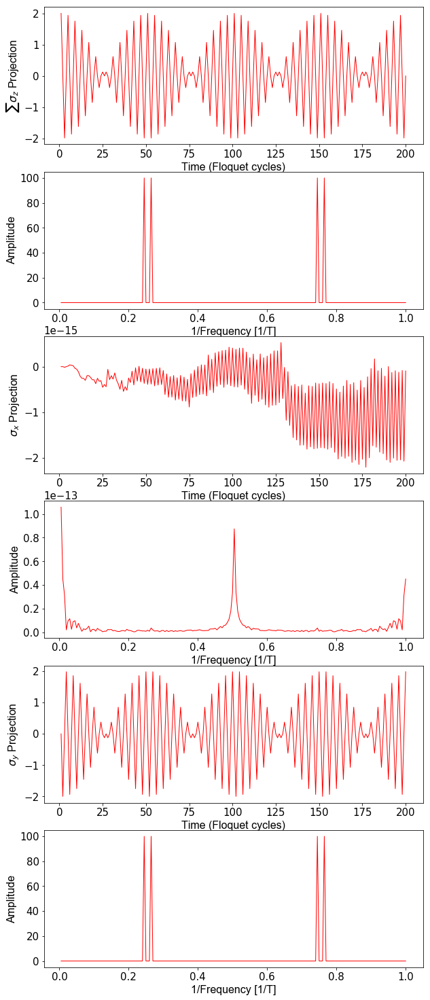

In [17]:
hfont = {'fontname':'Arial'}
fig, axes = plt.subplots(6,1,figsize=(10, 26))

p = axes[0].plot(times,observables, 'r', linewidth=1.0)
p = axes[1].plot(times/timess, np.abs(np.fft.fft(observables)), 'r', linewidth=1.0)
p = axes[2].plot(times,observablesX, 'r', linewidth=1.0)
p = axes[3].plot(times/timess, np.abs(np.fft.fft(observablesX)), 'r', linewidth=1.0)
p = axes[4].plot(times,observablesY, 'r', linewidth=1.0)
p = axes[5].plot(times/timess, np.abs(np.fft.fft(observablesY)), 'r', linewidth=1.0)

#axes[0].axis('tight')
axes[0].set_xlabel(r'Time (Floquet cycles)', fontsize=16, **hfont)
axes[0].set_ylabel(r'$\sum\sigma_z$ Projection', fontsize=16, **hfont)

axes[1].set_xlabel(r'1/Frequency [1/T]', fontsize=16, **hfont)
axes[1].set_ylabel(r'Amplitude', fontsize=16, **hfont)
#axes[1].set_title(r'FFT for the Time Crystal', fontsize=16, **hfont);

#axes[1].set_ylim((0, 500))
#axes[1].set_xlim((0.4, 0.6))

axes[2].set_xlabel(r'Time (Floquet cycles)', fontsize=16, **hfont)
axes[2].set_ylabel(r'$\sigma_x$ Projection', fontsize=16, **hfont)
axes[3].set_xlabel(r'1/Frequency [1/T]', fontsize=16, **hfont)
axes[3].set_ylabel(r'Amplitude', fontsize=16, **hfont)

axes[4].set_xlabel(r'Time (Floquet cycles)', fontsize=16, **hfont)
axes[4].set_ylabel(r'$\sigma_y$ Projection', fontsize=16, **hfont)
axes[5].set_xlabel(r'1/Frequency [1/T]', fontsize=16, **hfont)
axes[5].set_ylabel(r'Amplitude', fontsize=16, **hfont)


#matplotlib.pyplot.text(0.91, 0.91,'b', fontsize=24, weight="black",  verticalalignment='center', transform=axes.transAxes)

#plt.gcf().set_size_inches(15,5)
#plt.savefig("C:/neon/Simulated TC.pdf", bbox_inches="tight")

# State's degree of purity and V-N Entropy visualization

In [20]:
def density_Matrix(phiInitFull):
    return np.kron(phiInitFull, conjugate(phiInitFull)).reshape(size(phiInitFull),size(phiInitFull))

In [21]:
def entropy(phiInitFull):
    X=density_Matrix(phiInitFull)
    return -(X*log(X)).trace()

In [22]:
nSites = 2

eps=0.02                 #unperfection of pulses
alpha = np.pi/2-eps
w = 0.0                   #disorder
delta = deltaF(w, nSites)
g = 0.3                  #Interaction
T = 1                     # Period

timess=100
times = np.linspace(1, timess, timess)

In [23]:
U=Ufunc(nSites,alpha,g, T, delta)
phiInitFull = np.full((2**nSites), 0)
phiInitFull[0] = 1
#phiInitFull[3] = 1  

In [24]:
Final = states(phiInitFull,timess)                ## Evolution of states

In [25]:
traces = []
entropies = []

for i in Final:
    traces.append((density_Matrix(i) ** 2).trace())
    entropies.append(entropy(i))

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in log
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in multiply
  This is separate from the ipykernel package so we can avoid doing imports until


C:\Anaconda3\lib\site-packages\numpy\core\numeric.py:492: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


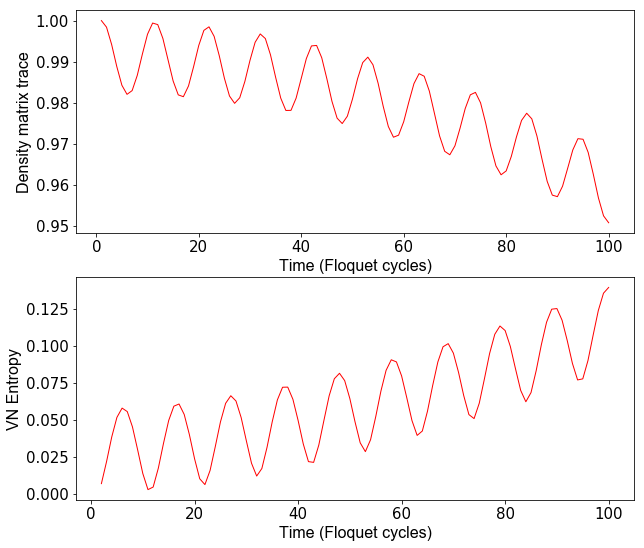

In [26]:
hfont = {'fontname':'Arial'}
fig, axes = plt.subplots(2,1,figsize=(10, 9))

p = axes[0].plot(times,traces, 'r', linewidth=1.0)
p = axes[1].plot(times,entropies, 'r', linewidth=1.0)

axes[0].set_xlabel(r'Time (Floquet cycles)', fontsize=16, **hfont)
axes[0].set_ylabel(r'Density matrix trace', fontsize=16, **hfont)

axes[1].set_xlabel(r'Time (Floquet cycles)', fontsize=16, **hfont)
axes[1].set_ylabel(r'VN Entropy', fontsize=16, **hfont)

# Variable Parameters  - eps

In [27]:
nSites = 2

eps_steps = 500
eps=np.linspace(0.00, 0.15, eps_steps)        #unperfection of pulses
alpha = np.pi/2-eps
w = 0.00                                        #disorder
delta = deltaF(w, nSites)
g = 0.05                              #Interaction
T = 1  
time_steps = 200
times = np.linspace(1, time_steps, time_steps)

In [28]:
Observables = np.zeros((eps_steps,time_steps), dtype=np.float)
Observables_fft = np.zeros((eps_steps,time_steps), dtype=np.float)

TracesDM = np.zeros((eps_steps,time_steps), dtype=np.float)
TracesDM_fft = np.zeros((eps_steps,time_steps), dtype=np.float)

VNEntropy = np.zeros((eps_steps,time_steps), dtype=np.float)
VNEntropy_fft = np.zeros((eps_steps,time_steps), dtype=np.float)

f = IntProgress(min=0, max=eps_steps) # instantiate the bar
display(f) # display the bar
    
for alpha_id, alpha_value in enumerate(alpha): 
    U=Ufunc(nSites,alpha_value,g,T,delta)
    #U=UfuncZZ(nSites,alpha_value,g,T,delta)
    #U=UfuncXX(nSites,alpha_value,g,T,delta)
    phiInitFull = np.full((2**nSites), 0)
    phiInitFull[0] = 1                             ##initial state

    Final = states(phiInitFull,time_steps)                ## Evolution of states
    
    sigZOp = tensorize1SiteMatrixKroneker(nSites, 1, 3)
    for i in range(2, nSites+1,1):
        sigZOp = sigZOp + tensorize1SiteMatrixKroneker(nSites, i, 3)
       
    observables = []
    traces = []
    entropies = []
      
    for i in Final:
        traces.append((density_Matrix(i) ** 2).trace())
        entropies.append(entropy(i))
        observables.append(np.dot(np.dot(np.conjugate(i).T,sigZOp),i).real)
    #print(alpha_id)
    f.value += 1
    Observables_fft[alpha_id] = np.fft.fft(observables)
    Observables[alpha_id] = observables
    TracesDM_fft[alpha_id] = np.fft.fft(traces)
    TracesDM[alpha_id] = traces
    VNEntropy_fft[alpha_id] = np.fft.fft(entropies)
    VNEntropy[alpha_id] = entropies
    

Widget Javascript not detected.  It may not be installed or enabled properly.


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in log
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in multiply
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:36: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:38: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:40: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:41: ComplexWarning: Casting complex val

C:\Anaconda3\lib\site-packages\numpy\core\_methods.py:29: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims)
C:\Anaconda3\lib\site-packages\numpy\core\_methods.py:26: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims)
C:\Anaconda3\lib\site-packages\matplotlib\colors.py:496: RuntimeWarning: invalid value encountered in less
  cbook._putmask(xa, xa < 0.0, -1)


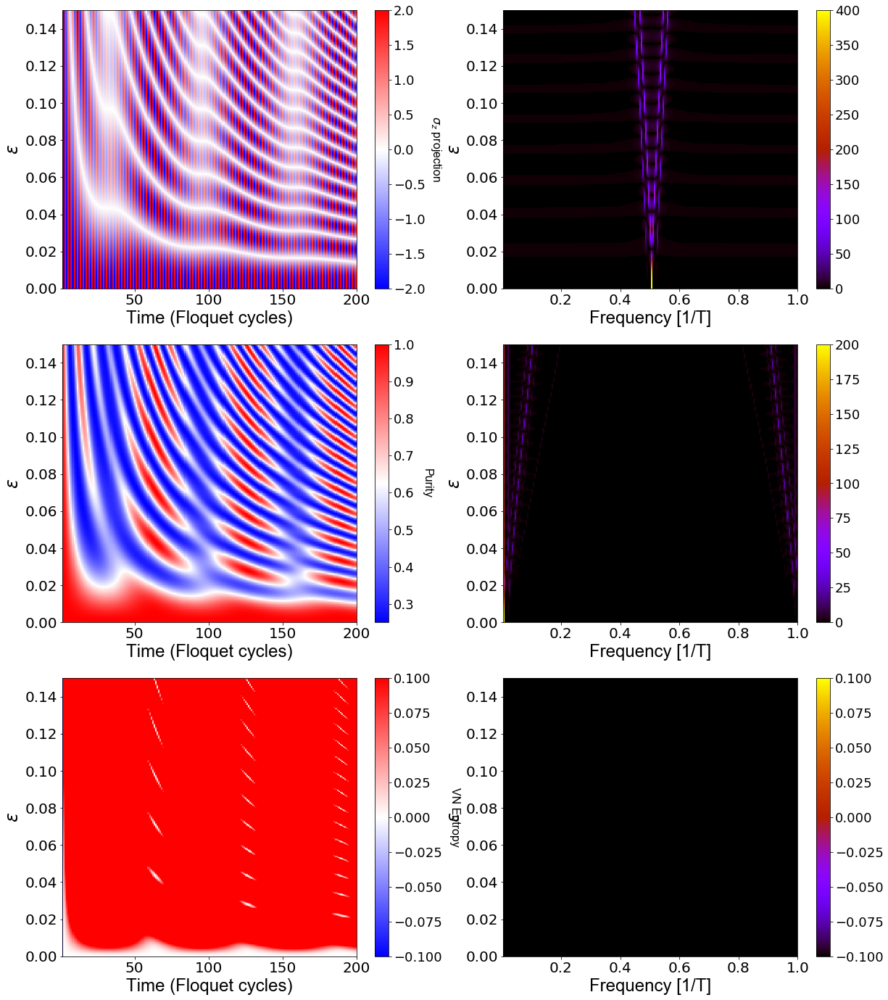

In [29]:
hfont = {'fontname':'Arial'}
fig, axes = plt.subplots(3,2,figsize=(20, 24))

p = axes[0,0].pcolor(times, eps, Observables, cmap=cm.bwr)

axes[0,0].axis('tight')
axes[0,0].set_xlabel(r'Time (Floquet cycles)', fontsize=24, **hfont)
axes[0,0].set_ylabel(r'$\epsilon$', fontsize=24, **hfont)


axes[0,0].tick_params(axis='x', labelsize=20)
axes[0,0].tick_params(axis='y', labelsize=20)

cb = fig.colorbar(p, ax=axes[0,0])
cb.set_label(r'$\sigma_z$ projection', labelpad=25, rotation=270, fontsize=16, **hfont)
cb.ax.tick_params(labelsize=18) 


p = axes[0,1].pcolor(times/time_steps, eps, np.abs(Observables_fft), cmap=cm.gnuplot)

axes[0,1].tick_params(axis='x', labelsize=20)
axes[0,1].tick_params(axis='y', labelsize=20)

axes[0,1].set_xlabel(r'Frequency [1/T]', fontsize=24, **hfont)
axes[0,1].set_ylabel(r'$\epsilon$', fontsize=24, **hfont)

#axes[0,1].set_xlim((0.4, 0.6))

cb = fig.colorbar(p, ax=axes[0,1])
#cb.set_label(r'Amplitude', labelpad=25, rotation=270, fontsize=24, **hfont)
cb.ax.tick_params(labelsize=18) 

#---------------------------------------------------------------------------
p = axes[1,0].pcolor(times, eps, TracesDM, cmap=cm.bwr)

axes[1,0].axis('tight')
axes[1,0].set_xlabel(r'Time (Floquet cycles)', fontsize=24, **hfont)
axes[1,0].set_ylabel(r'$\epsilon$', fontsize=24, **hfont)

axes[1,0].tick_params(axis='x', labelsize=20)
axes[1,0].tick_params(axis='y', labelsize=20)

cb = fig.colorbar(p, ax=axes[1,0])
cb.set_label(r'Purity', labelpad=25, rotation=270, fontsize=16, **hfont)
cb.ax.tick_params(labelsize=18) 

p = axes[1,1].pcolor(times/time_steps, eps, np.abs(TracesDM_fft), cmap=cm.gnuplot)

axes[1,1].tick_params(axis='x', labelsize=20)
axes[1,1].tick_params(axis='y', labelsize=20)

axes[1,1].set_xlabel(r'Frequency [1/T]', fontsize=24, **hfont)
axes[1,1].set_ylabel(r'$\epsilon$', fontsize=24, **hfont)

#axes[1,1].set_xlim((0.4, 0.6))
#axes[1,1].set_xlim((0.4, 0.6))

cb = fig.colorbar(p, ax=axes[1,1])
#cb.set_label(r'Amplitude', labelpad=25, rotation=270, fontsize=24, **hfont)
cb.ax.tick_params(labelsize=18) 

#---------------------------------------------------------------------------
p = axes[2,0].pcolor(times, eps, VNEntropy, cmap=cm.bwr)

axes[2,0].axis('tight')
axes[2,0].set_xlabel(r'Time (Floquet cycles)', fontsize=24, **hfont)
axes[2,0].set_ylabel(r'$\epsilon$', fontsize=24, **hfont)

axes[2,0].tick_params(axis='x', labelsize=20)
axes[2,0].tick_params(axis='y', labelsize=20)

cb = fig.colorbar(p, ax=axes[2,0])
cb.set_label(r'VN Entropy', labelpad=25, rotation=270, fontsize=16, **hfont)
cb.ax.tick_params(labelsize=18) 

p = axes[2,1].pcolor(times/time_steps, eps, np.abs(VNEntropy_fft), cmap=cm.gnuplot)

axes[2,1].tick_params(axis='x', labelsize=20)
axes[2,1].tick_params(axis='y', labelsize=20)

axes[2,1].set_xlabel(r'Frequency [1/T]', fontsize=24, **hfont)
axes[2,1].set_ylabel(r'$\epsilon$', fontsize=24, **hfont)

#axes[2,1].set_xlim((0.4, 0.6))
#axes[2,1].set_xlim((0.4, 0.6))

cb = fig.colorbar(p, ax=axes[2,1])
#cb.set_label(r'Amplitude', labelpad=25, rotation=270, fontsize=24, **hfont)
cb.ax.tick_params(labelsize=18) 


#matplotlib.pyplot.text(0.91, 0.91,'b', fontsize=24, weight="black",  verticalalignment='center', transform=axes.transAxes)

#plt.gcf().set_size_inches(20,24)
#plt.savefig("C:/neon/Simulated TC_3D_1spins_g=0_T=1_100_Floquet_steps.pdf", bbox_inches="tight")

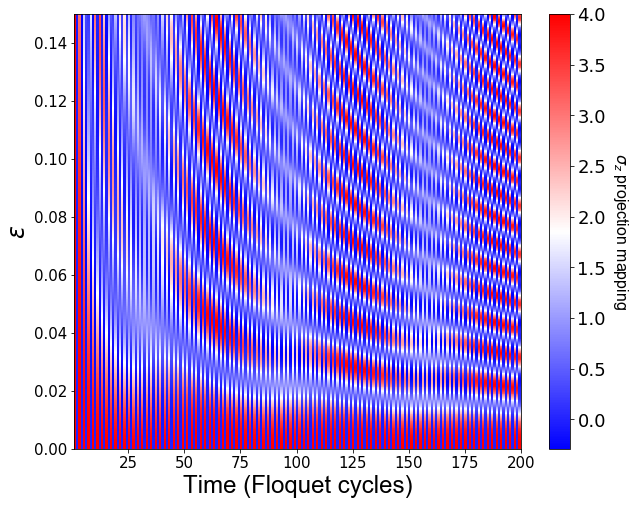

In [268]:
hfont = {'fontname':'Arial'}
fig, axes = plt.subplots(figsize=(10,8))

p = axes.pcolor(times, eps, Observables+TracesDM*2, cmap=cm.bwr)

axes.axis('tight')
axes.set_xlabel(r'Time (Floquet cycles)', fontsize=24, **hfont)
axes.set_ylabel(r'$\epsilon$', fontsize=24, **hfont)

cb = fig.colorbar(p, ax=axes)
cb.set_label(r'$\sigma_z$ projection mapping', labelpad=25, rotation=270, fontsize=16, **hfont)
cb.ax.tick_params(labelsize=18) 

# Animation

In [51]:
from IPython.display import HTML

In [52]:
from matplotlib import animation

In [53]:
#We need this for codec and visualization of time dynamics

from base64 import b64encode

def display_embedded_video(filename):
    video = open(filename, "rb").read()
    video_encoded = b64encode(video).decode("ascii")
    video_tag = '<video controls alt="test" src="data:video/x-m4v;base64,{0}">'.format(video_encoded)
    return HTML(video_tag)

In [54]:
plt.rcParams['animation.ffmpeg_path'] ='C:\\ffmpeg\\bin\\ffmpeg.exe'  # path to codec location

In [55]:
mywriter = animation.FFMpegWriter()

In [66]:
nSites = 2

eps_steps = 200
eps=np.linspace(0.00, 0.3, eps_steps)        #unperfection of pulses
alpha = np.pi/2-eps
w = 0.00                                        #disorder
delta = deltaF(w, nSites)
g = 0.1                              #Interaction
T = 1  
time_steps = 200
times = np.linspace(1, time_steps, time_steps)

A_steps = 100
A = linspace(0, g, A_steps)

In [68]:
delta = [10,10]

In [69]:
def plot_Time_crystal(Coupling, fig=None, axes=None):
       
    
    Observables = np.zeros((eps_steps,time_steps), dtype=np.float)
    #Observables_fft = np.zeros((eps_steps,time_steps), dtype=np.float)
    
    #ObservablesX = np.zeros((eps_steps,time_steps), dtype=np.float)
    #ObservablesX_fft = np.zeros((eps_steps,time_steps), dtype=np.float)

    #TracesDM = np.zeros((eps_steps,time_steps), dtype=np.float)
    #TracesDM_fft = np.zeros((eps_steps,time_steps), dtype=np.float)

    #VNEntropy = np.zeros((eps_steps,time_steps), dtype=np.float)
    #VNEntropy_fft = np.zeros((eps_steps,time_steps), dtype=np.float)

    sigXOp = tensorize1SiteMatrixKroneker(nSites, 1, 1)
    sigYOp = tensorize1SiteMatrixKroneker(nSites, 1, 2)
    sigZOp = tensorize1SiteMatrixKroneker(nSites, 1, 3)
    for i in range(2, nSites+1,1):
        sigXOp = sigXOp + tensorize1SiteMatrixKroneker(nSites, i, 1)
        sigYOp = sigYOp + tensorize1SiteMatrixKroneker(nSites, i, 2)
        sigZOp = sigZOp + tensorize1SiteMatrixKroneker(nSites, i, 3)
            
    for alpha_id, alpha_value in enumerate(alpha): 
        #print (alpha_value)
        #U=Ufunc(nSites,alpha_value,Coupling,T,delta)
        U=Ufunc_all_to_all(nSites,alpha_value,Coupling,T,delta)
        #U=UfuncZZ(nSites,alpha_value,g,T,delta)
        #U=UfuncXX(nSites,alpha_value,g,T,delta)
        phiInitFull = np.full((2**nSites), 0)
        phiInitFull[0] = 1                             ##initial state

        Final = states_U(phiInitFull,time_steps, U)                ## Evolution of states
 
        observables = []
        #observables = []
        #traces = []
        #entropies = []
    
        for i in Final:
            #traces.append((density_Matrix(i) ** 2).trace())
            #entropies.append(entropy(i))
            observables.append(np.dot(np.dot(np.conjugate(i).T,sigZOp),i).real)
            #observablesX.append(np.dot(np.dot(np.conjugate(i).T,sigXOp),i).real)
            
        #Observables_fft[alpha_id] = np.fft.fft(observables)
        Observables[alpha_id] = observables
        #ObservablesX[alpha_id] = observablesX
        #TracesDM_fft[alpha_id] = np.fft.fft(traces)
        #TracesDM[alpha_id] = traces
        #VNEntropy_fft[alpha_id] = np.fft.fft(entropies)
        #VNEntropy[alpha_id] = entropies     
        
    hfont = {'fontname':'Arial'}
    if fig is None or axes is None:
        fig, axes = plt.subplots(1, 1, figsize=(8,8))

    #p = axes.pcolor(times, eps, Observables, cmap=cm.bwr)
    p = axes.pcolor(times, eps, Observables, cmap=cm.bwr)

    axes.axis('tight')
    axes.set_xlabel(r'Time (Floquet cycles)', fontsize=24, **hfont)
    axes.set_ylabel(r'$\epsilon$', fontsize=24, **hfont)


    axes.tick_params(axis='x', labelsize=20)
    axes.tick_params(axis='y', labelsize=20)

    #cb = fig.colorbar(p, ax=axes)
    #cb.set_label(r'$\sigma_z$ projection', labelpad=25, rotation=270, fontsize=16, **hfont)
    #cb.ax.tick_params(labelsize=18) 
    
    return fig, axes

In [71]:
hfont = {'fontname':'Arial'}
fig, axes = plt.subplots(1,1,figsize=(10, 8))

def update(n): 
    plot_Time_crystal(A[n], fig=fig, axes=axes)

anim = animation.FuncAnimation(fig, update, frames=A_steps)

anim.save('C:/notebooks/animations/Time_Molecula_2qubits_all_to_all_test.mp4', writer=mywriter)

plt.close(fig)

In [72]:
display_embedded_video("C:/notebooks/animations/Time_Molecula_2qubits_all_to_all_test.mp4")

In [59]:
display_embedded_video("C:/notebooks/animations/Time_Molecula_9qubits_all_to_all.mp4")

In [50]:
display_embedded_video("C:/notebooks/animations/Time_Molecula_2qubits_all_to_all.mp4")

In [46]:
display_embedded_video("C:/notebooks/animations/Time_Molecula_5qubits_all_to_all.mp4")

In [37]:
display_embedded_video("C:/notebooks/animations/Time_Molecula_4qubits_all_to_all.mp4")

In [64]:
display_embedded_video("C:/notebooks/animations/Time_Molecula_4qubits_all_to_all_disorder0.5.mp4")

In [33]:
display_embedded_video("C:/notebooks/animations/Time_Molecula_3qubits_all_to_all.mp4")

In [ ]:
display_embedded_video("C:/notebooks/animations/Time_Molecula_7Qubits_g=3.mp4")

In [ ]:
display_embedded_video("C:/notebooks/animations/Time_Molecula.mp4")

In [82]:
display_embedded_video("C:/notebooks/animations/Time_Molecula_SigmaX_1g.mp4")

In [78]:
display_embedded_video("C:/notebooks/animations/Time_Molecula_SigmaX.mp4")

In [74]:
display_embedded_video("C:/notebooks/animations/Time_Molecula_2pi.mp4")

In [50]:
display_embedded_video("C:/notebooks/animations/Time_Molecula_7.mp4")

# Animation for Purity

In [64]:
nSites = 2

eps_steps = 200
eps=np.linspace(0.00, 0.20, eps_steps)        #unperfection of pulses
alpha = np.pi/2-eps
w = 0.00                                        #disorder
delta = deltaF(w, nSites)
g = 0.2                              #Interaction
T = 1  
time_steps = 100
times = np.linspace(1, time_steps, time_steps)

A_steps = 100
A = linspace(0, g, A_steps)

In [65]:
def plot_Time_crystal(Coupling, fig=None, axes=None):
       
    #Observables = np.zeros((eps_steps,time_steps), dtype=np.float)
    #Observables_fft = np.zeros((eps_steps,time_steps), dtype=np.float)

    TracesDM = np.zeros((eps_steps,time_steps), dtype=np.float)
    #TracesDM_fft = np.zeros((eps_steps,time_steps), dtype=np.float)

    #VNEntropy = np.zeros((eps_steps,time_steps), dtype=np.float)
    #VNEntropy_fft = np.zeros((eps_steps,time_steps), dtype=np.float)

    #sigZOp = tensorize1SiteMatrixKroneker(nSites, 1, 3)
    #for i in range(2, nSites+1,1):
        #sigZOp = sigZOp + tensorize1SiteMatrixKroneker(nSites, i, 3)
            
    for alpha_id, alpha_value in enumerate(alpha): 
        #print (alpha_value)
        U=Ufunc(nSites,alpha_value,Coupling,T,delta)
        #U=UfuncZZ(nSites,alpha_value,g,T,delta)
        #U=UfuncXX(nSites,alpha_value,g,T,delta)
        phiInitFull = np.full((2**nSites), 0)
        phiInitFull[0] = 1                             ##initial state

        Final = states_U(phiInitFull,time_steps, U)                ## Evolution of states
 
        #observables = []
        traces = []
        #entropies = []
      
        for i in Final:
            traces.append((density_Matrix(i) ** 2).trace())
            #entropies.append(entropy(i))
            #observables.append(np.dot(np.dot(np.conjugate(i).T,sigZOp),i).real)
            
        #Observables_fft[alpha_id] = np.fft.fft(observables)
        #Observables[alpha_id] = observables
        #TracesDM_fft[alpha_id] = np.fft.fft(traces)
        TracesDM[alpha_id] = traces
        #VNEntropy_fft[alpha_id] = np.fft.fft(entropies)
        #VNEntropy[alpha_id] = entropies     
        
    hfont = {'fontname':'Arial'}
    if fig is None or axes is None:
        fig, axes = plt.subplots(1, 1, figsize=(8,8))

    p = axes.pcolor(times, eps, TracesDM, cmap=cm.bwr)

    axes.axis('tight')
    axes.set_xlabel(r'Time (Floquet cycles)', fontsize=24, **hfont)
    axes.set_ylabel(r'$\epsilon$', fontsize=24, **hfont)


    axes.tick_params(axis='x', labelsize=20)
    axes.tick_params(axis='y', labelsize=20)

    #cb = fig.colorbar(p, ax=axes)
    #cb.set_label(r'$\sigma_z$ projection', labelpad=25, rotation=270, fontsize=16, **hfont)
    #cb.ax.tick_params(labelsize=18) 
    
    return fig, axes

In [66]:
hfont = {'fontname':'Arial'}
fig, axes = plt.subplots(1,1,figsize=(10, 8))

def update(n): 
    plot_Time_crystal(A[n], fig=fig, axes=axes)

anim = animation.FuncAnimation(fig, update, frames=A_steps)

anim.save('C:/notebooks/animations/Time_Molecula_purity.mp4', writer=mywriter)

plt.close(fig)

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:38: ComplexWarning: Casting complex values to real discards the imaginary part


In [68]:
display_embedded_video("C:/notebooks/animations/Time_Molecula_purity.mp4")

In [54]:
display_embedded_video("C:/notebooks/animations/Time_Molecula_purity_7.mp4")